<a href="https://colab.research.google.com/github/santiagoahl/land-cover-segmentation/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Land cover **segmentation**

>[Land cover segmentation](#scrollTo=u2QwcNCnwcd-)

>[Libraries & Modules](#scrollTo=Bd6fH_rGwgs4)

>[Data import](#scrollTo=k7-uwN5SwiW4)

>[Data-viz](#scrollTo=xzFowXlJwllq)

>[Data preprocessing](#scrollTo=be7p1uhAwnY-)

>>[Data cleaning](#scrollTo=LDAZxKoYlXpL)

>[Training](#scrollTo=7dze0c_wwo9h)

>>[CNN](#scrollTo=BqQ5l3nuNksC)

>>[Hi](#scrollTo=Bs7a2Ksn5KJQ)

>>[Vision Transformer](#scrollTo=g2MpLSLdNlzT)

>[Testing](#scrollTo=qs1GYHz2xFJv)

>>[CNN](#scrollTo=CtyvBP0UfC-t)

>>[Vision Transformer](#scrollTo=q-lXEYiwfC-1)

>[Model export](#scrollTo=1wESuRqyxGR4)

>[Model import](#scrollTo=kzw1Ll5ixcCA)

>[Skimage](#scrollTo=HlzClfeBQ271)



# Libraries & Modules

In [1]:
%%capture
!pip install transformers

In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import cv2 as cv

# CNN
from tensorflow.keras.models import Sequential
from tensorflow.keras import  regularizers
from tensorflow.keras.layers import Conv2D, Dropout, Dense, AveragePooling2D, MaxPooling2D, Flatten, Activation
from tqdm.keras import TqdmCallback 

# Vision transformers

#from transformers.models.vit.feature_extraction_vit import ViTFeatureExtractor
#from transformers import ViTFeatureExtractor, ViTForImageClassification, TrainingArguments, Trainer

import joblib

import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.model_selection import train_test_split
from tqdm.keras import TqdmCallback
from google.colab import drive

In [143]:
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

# Data import

In [ ]:
!unzip '/content/drive/MyDrive/personal-projects/land-cover-segmentation/data/dataset.zip';

In [4]:
class_path = '/content/class_dict.csv'
data_path = '/content/metadata.csv'

In [5]:
labels = pd.read_csv(class_path)
labels

,name,r,g,b
0,urban_land,0,255,255
1,agriculture_land,255,255,0
2,rangeland,255,0,255
3,forest_land,0,255,0
4,water,0,0,255
5,barren_land,255,255,255
6,unknown,0,0,0


In [35]:
df = pd.read_csv(data_path)
df.head()

,image_id,split,sat_image_path,mask_path
0,100694,train,train/100694_sat.jpg,train/100694_mask.png
1,102122,train,train/102122_sat.jpg,train/102122_mask.png
2,10233,train,train/10233_sat.jpg,train/10233_mask.png
3,103665,train,train/103665_sat.jpg,train/103665_mask.png
4,103730,train,train/103730_sat.jpg,train/103730_mask.png


In [87]:
train_data_paths = df[df['split']=='train']
test_data_paths = df[df['split']=='test']

In [88]:
train_data_paths

,image_id,split,sat_image_path,mask_path
0,100694,train,train/100694_sat.jpg,train/100694_mask.png
1,102122,train,train/102122_sat.jpg,train/102122_mask.png
2,10233,train,train/10233_sat.jpg,train/10233_mask.png
3,103665,train,train/103665_sat.jpg,train/103665_mask.png
4,103730,train,train/103730_sat.jpg,train/103730_mask.png
...,...,...,...,...
798,992507,train,train/992507_sat.jpg,train/992507_mask.png
799,994520,train,train/994520_sat.jpg,train/994520_mask.png
800,995492,train,train/995492_sat.jpg,train/995492_mask.png
801,997521,train,train/997521_sat.jpg,train/997521_mask.png


# Data-viz

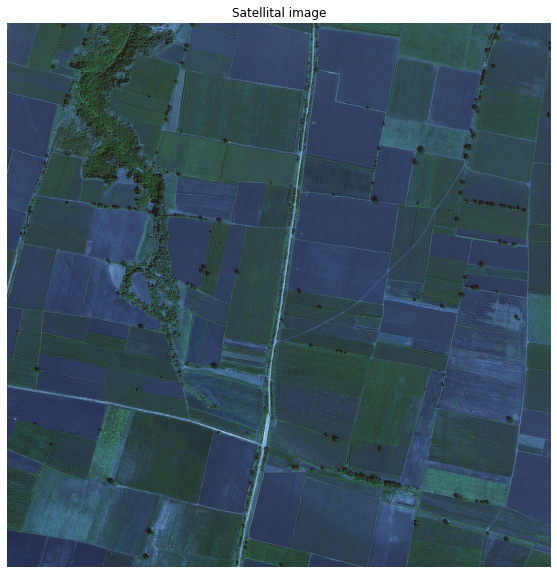

In [ ]:
sample_path = train_data['sat_image_path'][3]
sample_image = cv.imread(sample_path)

plt.figure(figsize=(10, 10))
plt.title('Satellital image')
plt.imshow(sample_image)
plt.axis('off')
plt.show()

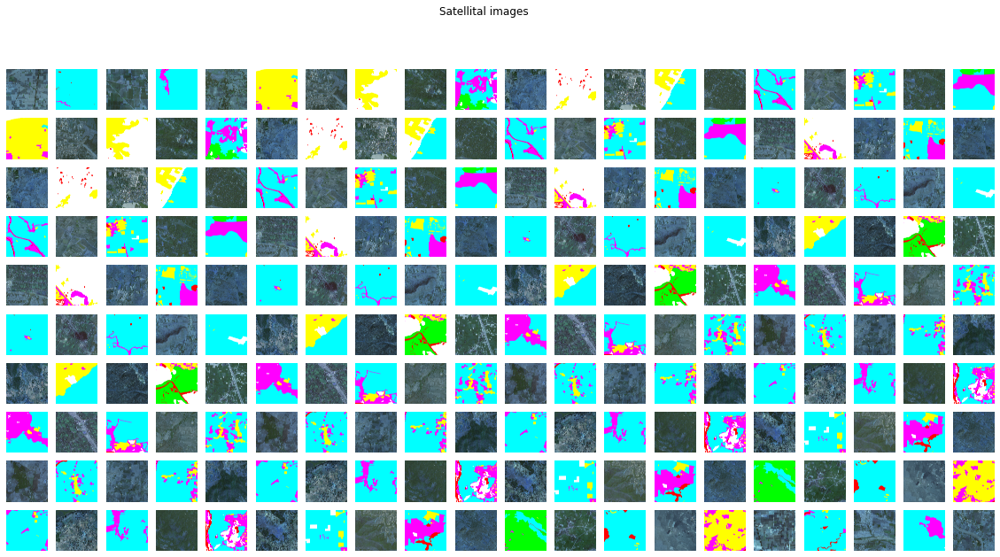

In [ ]:
sample1 = train_data['sat_image_path'][:200]
sample2 = train_data['mask_path'][:200]

i=-2

fig, ax = plt.subplots(ncols=20, nrows=10, figsize=(20, 10))
for x in range(10):
  i+=1
  for y in range(20):
    i+=1
    if i%2==0:
      path = sample1[5*x+y]
    else:
      path = sample2[5*x+y]
    image = cv.imread(path)
    ax[x, y].imshow(image)
    ax[x, y].axis('off')
plt.suptitle('Satellital images')
fig.show()

Notice that the land segmentation is given by: 

| Class  | Colour |
| --- | --- |
| `urban_land` |  Yellow |
| `agriculture_land` | Cyan |
| `rangeland` | Pink |
| `forest_land` | Green |
| `water` | Blue (or red?) |
| `barren_land` | White |
| `unknown` | Black |


Observe how segmentations are displayed:

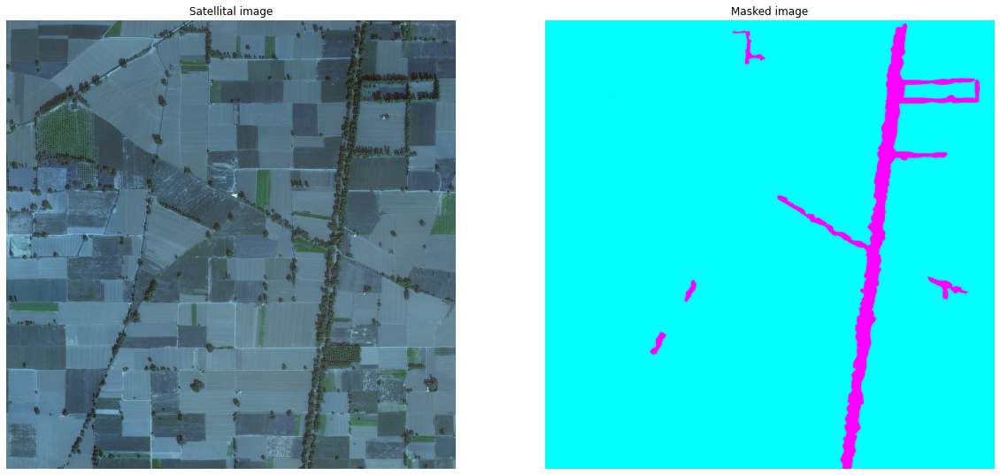

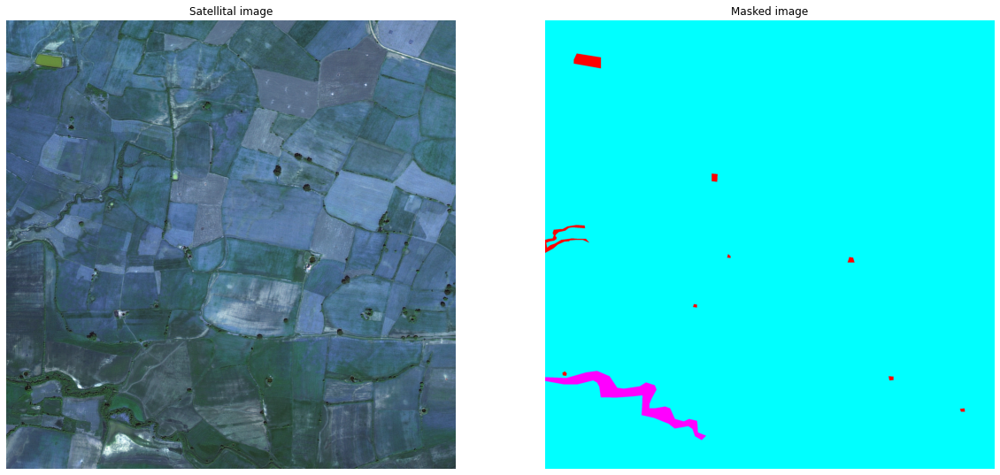

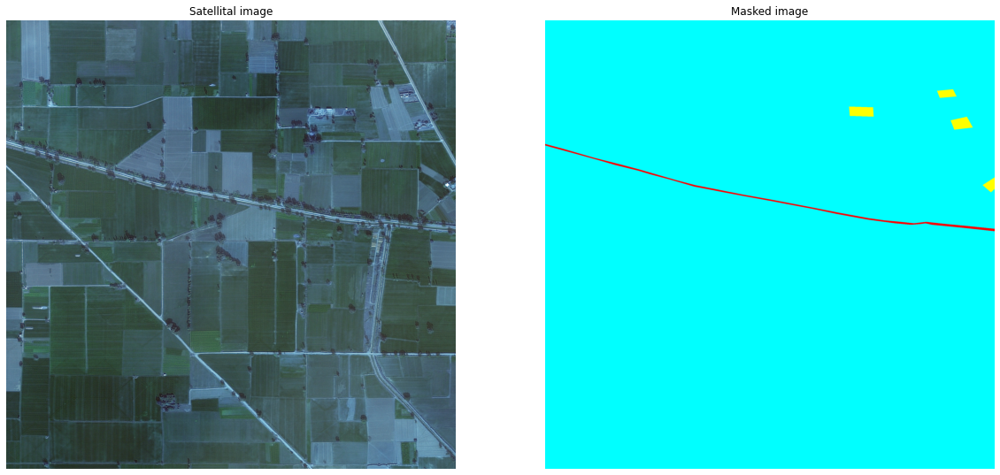

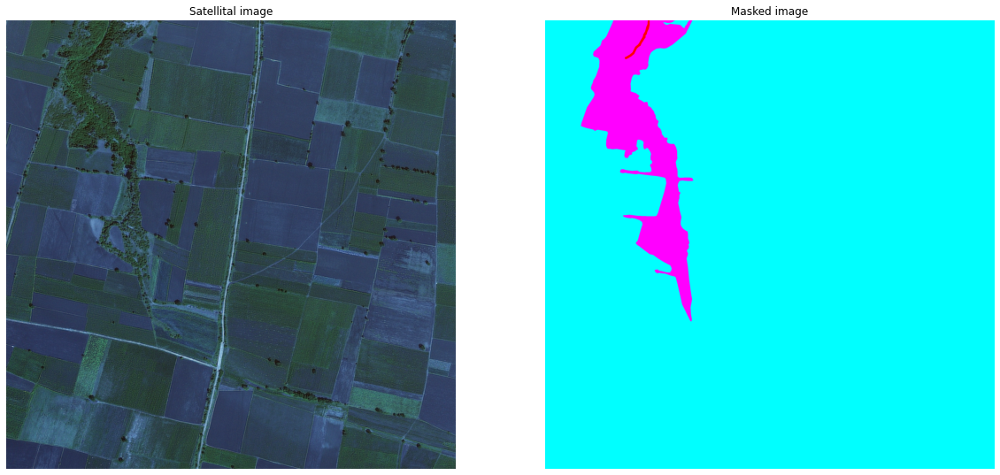

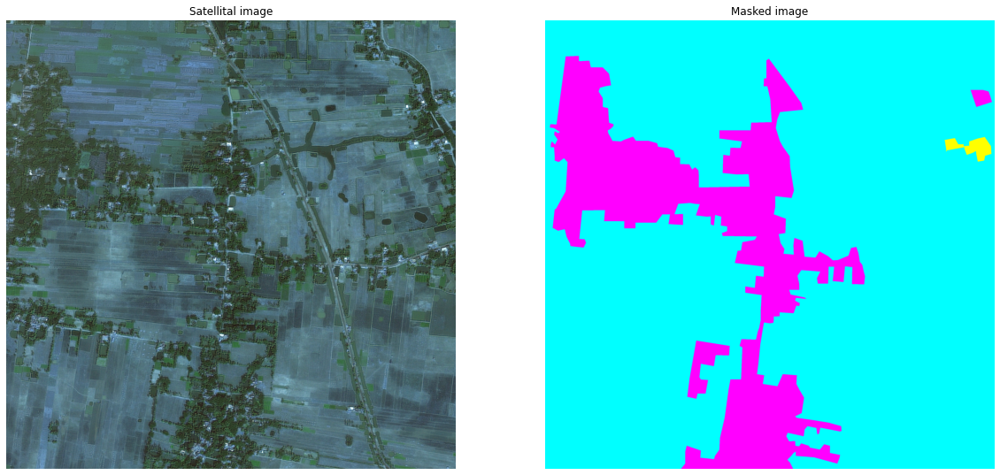

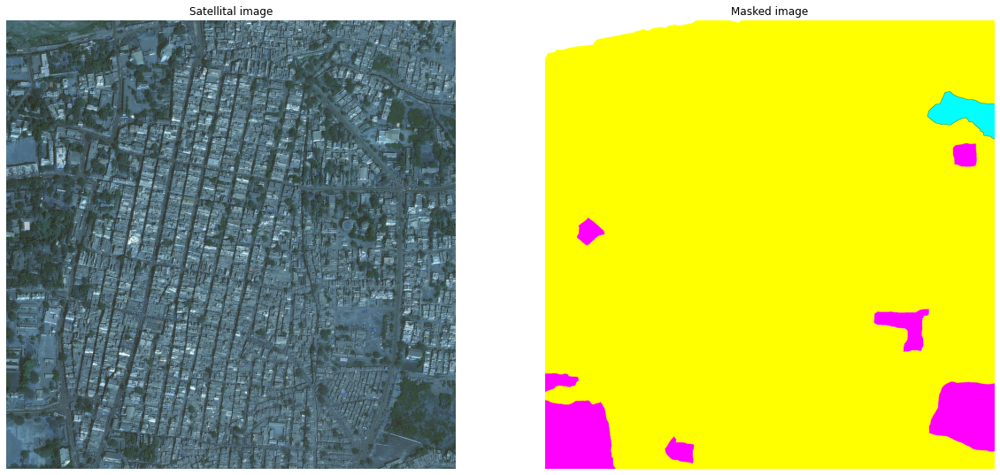

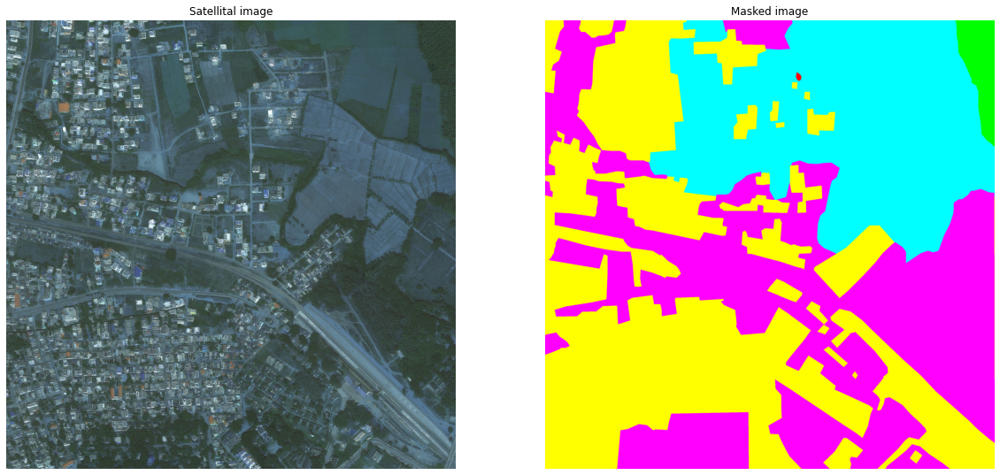

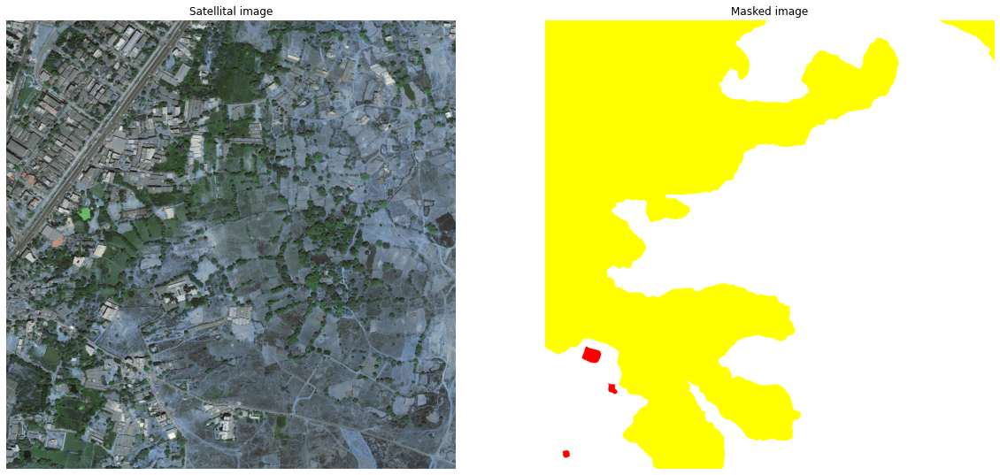

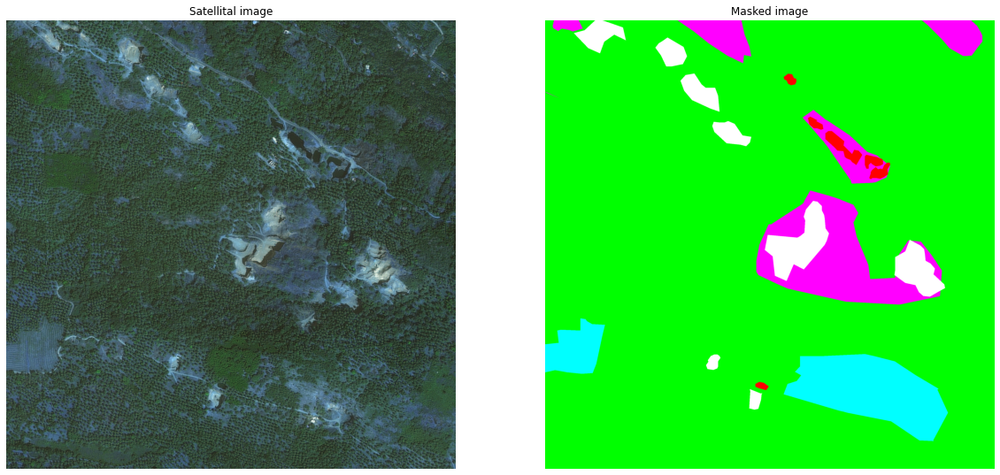

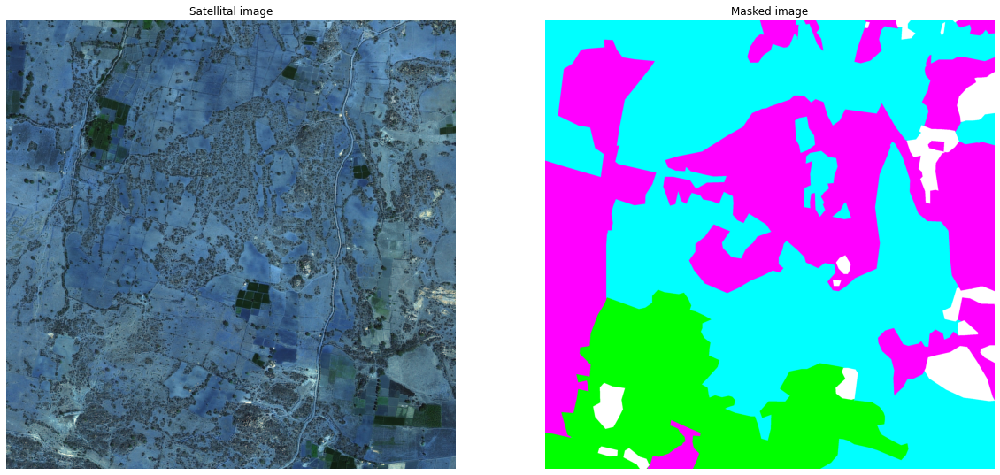

In [ ]:
n = 400

#plt.title('Land segmentation')

for n in range(10):
  im1 = cv.imread(train_data['sat_image_path'][n])
  im2 = cv.imread(train_data['mask_path'][n])

  fig, ax = plt.subplots(ncols=2, nrows=1, figsize=(20, 10))

  ax[0].imshow(im1)
  ax[0].set_title('Satellital image')
  ax[0].axis('off')

  ax[1].imshow(im2)
  ax[1].set_title('Masked image')
  ax[1].axis('off')

fig.show()

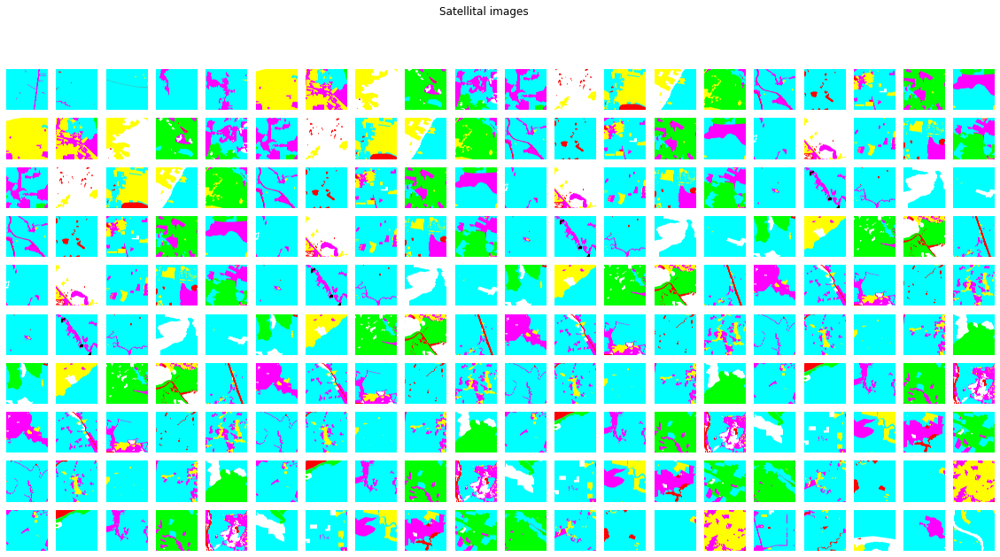

In [ ]:
sample = train_data['mask_path'][:200]

fig, ax = plt.subplots(ncols=20, nrows=10, figsize=(20, 10))
for x in range(10):
  for y in range(20):
    path = sample[5*x+y]
    image = cv.imread(path)
    ax[x, y].imshow(image)
    ax[x, y].axis('off')
plt.suptitle('Satellital images')
fig.show()

# Data preprocessing

In [ ]:
plt.imread(train_data['sat_image_path'][0])

array([[[129, 109,  82],
        [129, 109,  82],
        [127, 107,  80],
        ...,
        [104,  90,  64],
        [104,  88,  63],
        [104,  88,  62]],

       [[128, 108,  81],
        [127, 107,  80],
        [125, 105,  78],
        ...,
        [103,  88,  65],
        [105,  91,  65],
        [109,  93,  67]],

       [[125, 105,  78],
        [126, 106,  79],
        [128, 108,  81],
        ...,
        [107,  93,  67],
        [109,  95,  69],
        [114,  98,  72]],

       ...,

       [[155, 136,  96],
        [157, 138,  98],
        [154, 135,  95],
        ...,
        [157, 145, 103],
        [150, 138,  96],
        [156, 144, 102]],

       [[149, 129,  92],
        [152, 132,  95],
        [151, 132,  92],
        ...,
        [148, 136,  94],
        [135, 123,  81],
        [134, 122,  80]],

       [[149, 129,  96],
        [149, 129,  96],
        [149, 129,  96],
        ...,
        [139, 127,  85],
        [137, 125,  83],
        [138, 126,  84]]

In [ ]:
train_data['image'] = pd.Series([np.array([])]*len(train_data))

<ipython-input-19-33c2de0f16e1>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['image'] = pd.Series([np.array([])]*len(train_data))


In [ ]:
X_train = []
X_test = []

for x in range(len(train_data)):
  image = plt.imread(train_data['sat_image_path'][x])
  X_train.append(image)

In [ ]:
X_train = np.array(X_train)

In [ ]:
for x in range(len(train_data)):
  image = plt.imread(train_data['mask_path'][x])
  X_test.append(image)

X_test = np.array(X_test)

In [ ]:
len(X_train)

## Data cleaning

We are looking for deleting the data which associated paths are empty.

In [31]:
df['mask_path'].isnull().sum() / len(df['mask_path']) * 100
#df['sat_image_path'].isnull().sum() / len(df)

29.930191972076788

In [33]:
df[df['mask_path'].isnull()]

,image_id,split,sat_image_path,mask_path
803,105036,valid,valid/105036_sat.jpg,NaN
804,107780,valid,valid/107780_sat.jpg,NaN
805,108490,valid,valid/108490_sat.jpg,NaN
806,127801,valid,valid/127801_sat.jpg,NaN
807,128240,valid,valid/128240_sat.jpg,NaN
...,...,...,...,...
1141,979233,test,test/979233_sat.jpg,NaN
1142,983689,test,test/983689_sat.jpg,NaN
1143,988205,test,test/988205_sat.jpg,NaN
1144,989953,test,test/989953_sat.jpg,NaN


# Training

## CNN

In [8]:
model = Sequential()

model.add(Dense(255, input_shape=(255, 255, 3)))
model.add(Conv2D(100, 3, 3, activation='relu'))
model.add(Dropout(0.5))
model.add(Conv2D(100, 3, 3, activation='relu'))
model.add(Dropout(0.5))

In [ ]:
train_images_arrays = np.array(
    [cv.imread(train_data['sat_image_path'][i]) for i in range(len(train_data['sat_image_path']))]
)

train_masks_arrays = np.array(
    [cv.imread(train_data['mask_path'][i]) for i in range(len(train_data['mask_path']))]
)

In [38]:
train_image_paths, train_mask_paths, val_image_paths, val_mask_paths = (train_data_paths['sat_image_path'], train_data_paths['mask_path'], test_data_paths['sat_image_path'], test_data_paths['mask_path'])

In [105]:
X_train, X_test, y_train, y_test = train_test_split(train_image_paths, train_mask_paths, test_size=0.2, random_state=42)

In [91]:
X_train.res

432    train/586222_sat.jpg
582    train/736869_sat.jpg
442    train/599743_sat.jpg
643     train/81039_sat.jpg
334    train/476582_sat.jpg
               ...         
71     train/170535_sat.jpg
106    train/211316_sat.jpg
270     train/40168_sat.jpg
435    train/587968_sat.jpg
102     train/21023_sat.jpg
Name: sat_image_path, Length: 642, dtype: object

In [110]:
$ Reindexing

X_train = pd.Series(X_train.tolist())
X_test = pd.Series(X_test.tolist())

y_train = pd.Series(y_train.tolist())
y_test = pd.Series(y_test.tolist())

In [108]:
X_train

0      train/586222_sat.jpg
1      train/736869_sat.jpg
2      train/599743_sat.jpg
3       train/81039_sat.jpg
4      train/476582_sat.jpg
               ...         
637    train/170535_sat.jpg
638    train/211316_sat.jpg
639     train/40168_sat.jpg
640    train/587968_sat.jpg
641     train/21023_sat.jpg
Length: 642, dtype: object

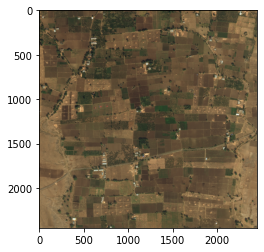

In [109]:
plt.imshow(plt.imread(X_train[2]))

In [114]:
def load_data(images_path, masks_path):
  data = {'images': [], 'masks': []}

  for i in range(len(images_path)):
    #Read images
    img = plt.imread(images_path[i])
    mask = plt.imread(masks_path[i])
    #Img Resize
    img = cv.resize(img, (256, 256))
    mask = cv.resize(mask, (256, 256))
    #Save images
    data['images'].append(img)
    data['masks'].append(mask)
  #Save sample as a tensor
  data['images'] = np.array(data['images'])
  data['masks'] = np.array(data['masks'])

  return data

In [115]:
train_data = load_data(images_path=X_train, masks_path=y_train)
test_data = load_data(images_path=X_test, masks_path=y_test)

In [119]:
train_data['images'].shape

(642, 256, 256, 3)

In [9]:
def create_conv_block(input_tensor, num_filters):
  """
    Helps us to create the convolutional blocks
  """
  # First Conv layer
  x = tf.keras.layers.Conv2D(filters=num_filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(input_tensor)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)
  # Second Conv layer

  x = tf.keras.layers.Conv2D(filters=num_filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.Activation('relu')(x)

  return x

In [10]:
def create_unet(input_shape, num_filters=16, dropout=0.1):
  """
    Creates the U-Net Architecture
  """
  # Encoder
    # First conv block
  c1 = create_conv_block(input_shape, num_filters * 1)
  p1 = tf.keras.layers.MaxPool2D((2, 2))(c1)
  p1 = tf.keras.layers.Dropout(dropout)(p1)
    # Second conv block
  c2 = create_conv_block(p1, num_filters * 2)
  p2 = tf.keras.layers.MaxPool2D((2, 2))(c2)
  p2 = tf.keras.layers.Dropout(dropout)(p2)
    # Third conv block
  c3 = create_conv_block(p2, num_filters * 4)
  p3 = tf.keras.layers.MaxPool2D((2, 2))(c3)
  p3 = tf.keras.layers.Dropout(dropout)(p3)
    # Fourth conv block
  c4 = create_conv_block(p3, num_filters * 8)
  p4 = tf.keras.layers.MaxPool2D((2, 2))(c4)
  p4 = tf.keras.layers.Dropout(dropout)(p4)

  c5 = create_conv_block(p4, num_filters*16)

  # Decoder
    # First block
  u6 = tf.keras.layers.Conv2DTranspose(num_filters*8, (3, 3), strides=(2, 2), padding='same')(c5)
  u6 = tf.keras.layers.concatenate([u6, c4])
  u6 = tf.keras.layers.Dropout(dropout)(u6)
  c6 = create_conv_block(u6, num_filters*8)
    # Second block
  u7 = tf.keras.layers.Conv2DTranspose(num_filters*4, (3, 3), strides=(2, 2), padding='same')(c6)
  u7 = tf.keras.layers.concatenate([u7, c3])
  u7 = tf.keras.layers.Dropout(dropout)(u7)
  c7 = create_conv_block(u7, num_filters*4)
    #Third block
  u8 = tf.keras.layers.Conv2DTranspose(num_filters*2, (3, 3), strides=(2, 2), padding='same')(c7)
  u8 = tf.keras.layers.concatenate([u8, c2])
  u8 = tf.keras.layers.Dropout(dropout)(u8)
  c8 = create_conv_block(u8, num_filters*2) 
    # Fourth block
  u9 = tf.keras.layers.Conv2DTranspose(num_filters*1, (3, 3), strides=(2, 2), padding='same')(c8)
  u9 = tf.keras.layers.concatenate([u9, c1])
  c9 = tf.keras.layers.Dropout(dropout)(u9)

  output = tf.keras.layers.Conv2D(3, (1, 1), activation='sigmoid')(c9)
  model = tf.keras.Model(inputs = [input_shape], outputs=[output])
  
  return model

In [130]:
input_shape = train_data['masks'][0].shape
inputs = tf.keras.layers.Input(input_shape)

model = create_unet(inputs)

In [149]:
model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['accuracy'])

In [139]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_19 (Conv2D)             (None, 256, 256, 16  448         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_16 (BatchN  (None, 256, 256, 16  64         ['conv2d_19[0][0]']              
 ormalization)                  )                                                           

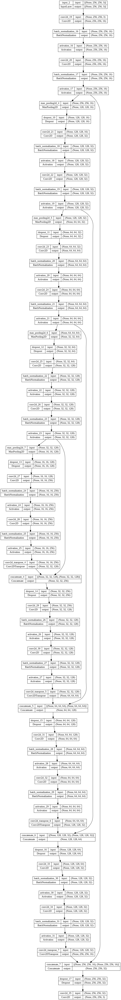

In [146]:
tf.keras.utils.plot_model(model, show_shapes=True)

In [150]:
checkpoint = tf.keras.callbacks.ModelCheckpoint('best.hdf5', monitor='accuracy', save_best_only=True, verbose=0)

In [ ]:
model_history = model.fit(train_data['images'], train_data['masks'],
                          epochs=200,
                          verbose=0,
                          callbacks=[checkpoint, TqdmCallback(verbose=1)]
                        )

## Vision Transformer

# Testing

## CNN

In [153]:
model_history = model_history.history

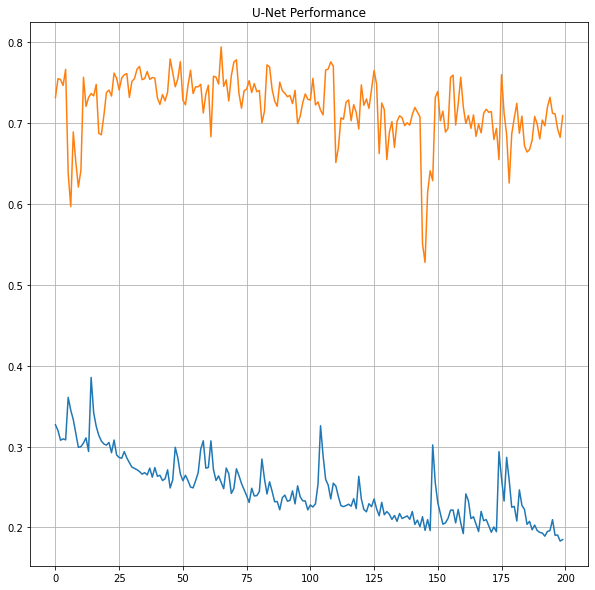

In [155]:
plt.figure(figsize=(10, 10))

plt.plot(model_history['loss'], label='Training loss')
plt.plot(model_history['accuracy'], label='Training accuracy')

plt.title('U-Net Performance')

plt.grid(True)
plt.show()

In [167]:
type(test_data['images'])

numpy.ndarray

In [168]:
def predict_test_samples(val_map, model):
  imgs = val_map['images']
  masks = val_map['masks']

  predicted_masks = model.predict(imgs)

  return imgs, predicted_masks, masks

In [185]:
def plot_predictions(image, mask_pred, ground_truth_mask):
  fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))

  ax[0].imshow(image)
  ax[0].set_title('Original satellital image')
  ax[0].axis('off')

  ax[1].imshow(mask_pred)
  ax[1].set_title('Predicted Mask')
  ax[1].axis('off')

  ax[2].imshow(ground_truth_mask)
  ax[2].set_title('Ground truth Mask')
  ax[2].axis('off')

  plt.show()


In [171]:
imgs, predicted_masks, masks = predict_test_samples(test_data, model)

6/6 [==============================] - 0s 85ms/step


In [ ]:
model.evaluate(X_test, y_test)

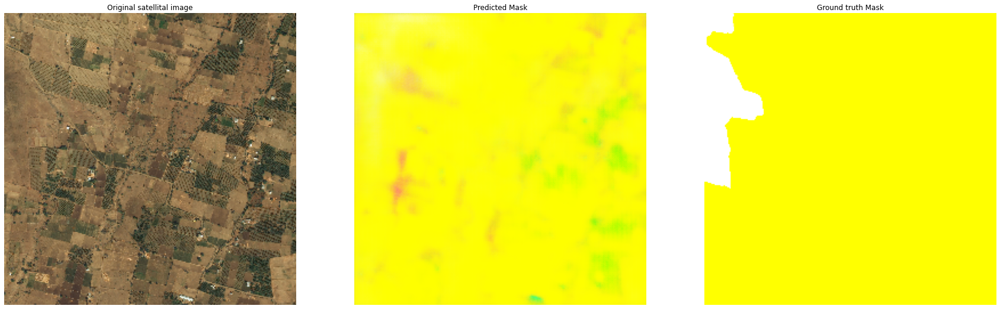

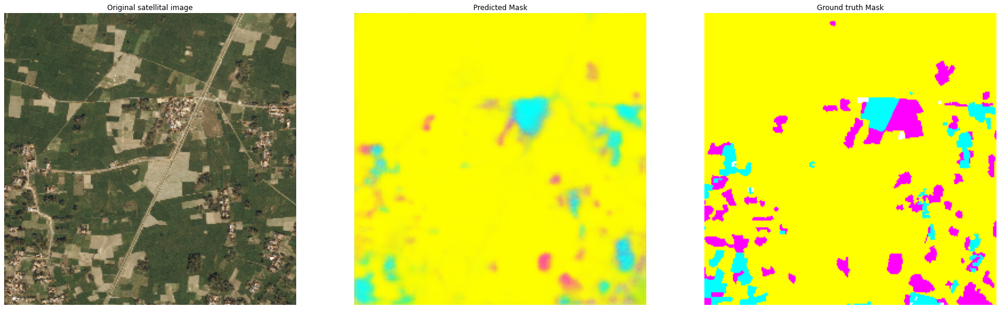

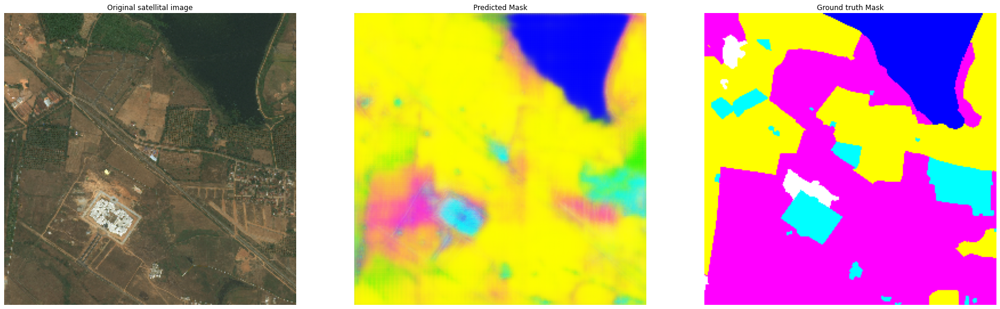

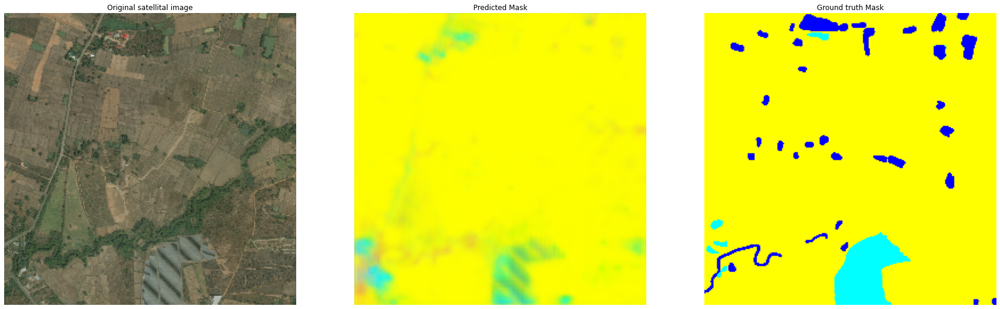

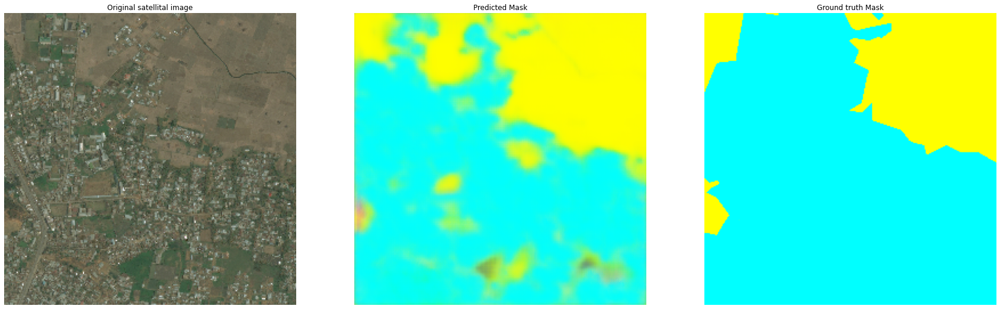

...

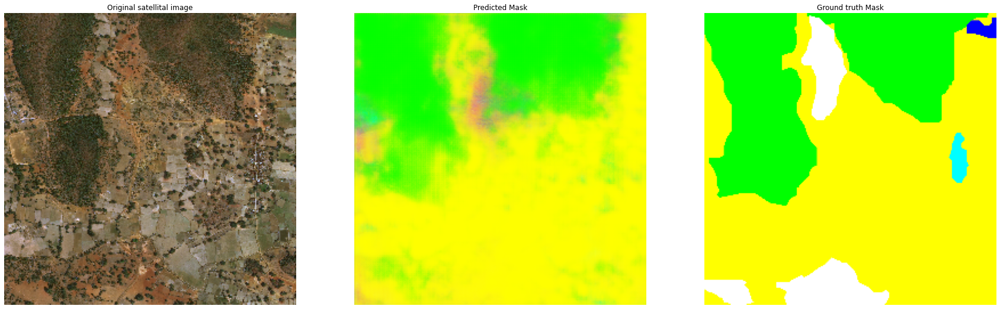

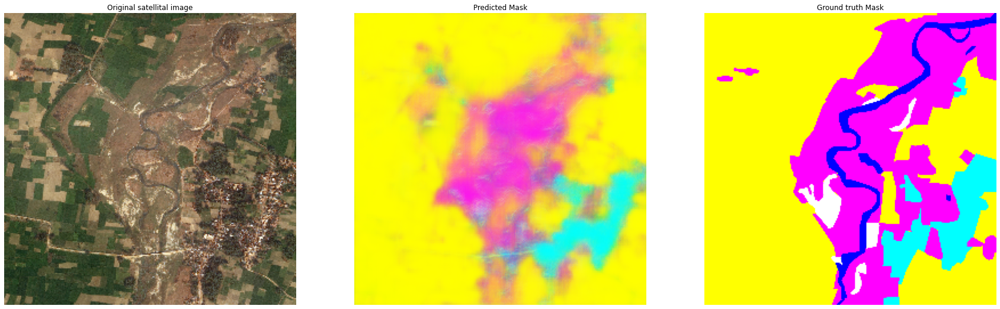

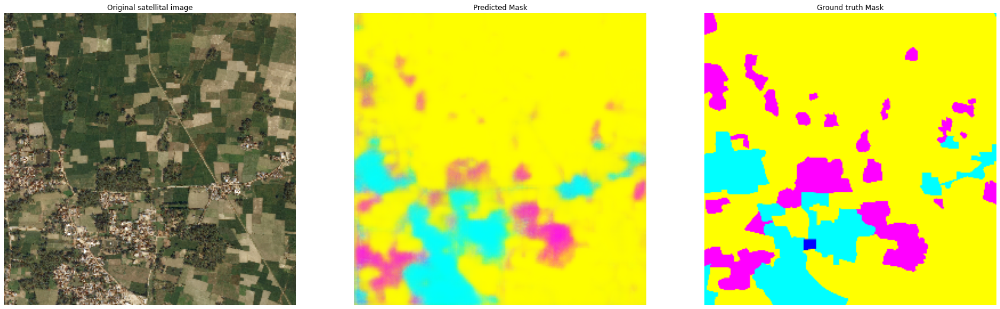

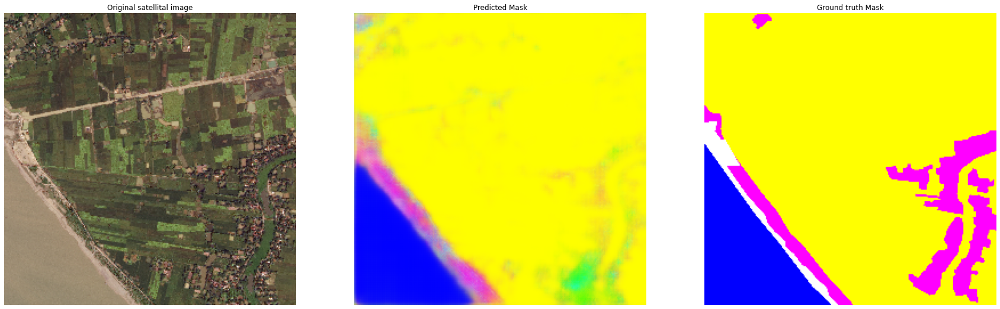

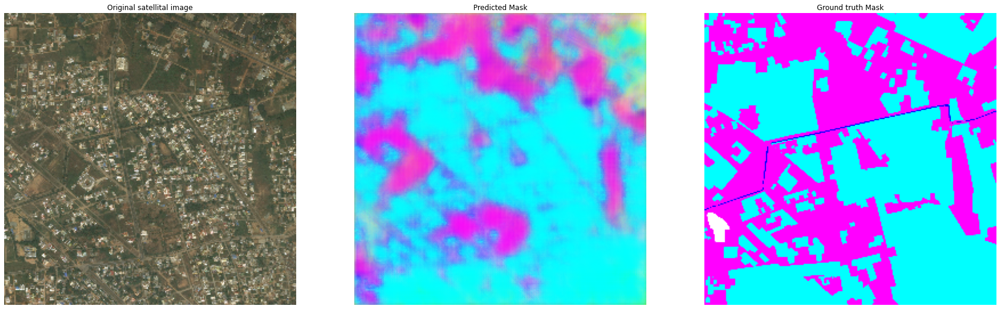

In [192]:
for i in range(30):
  plot_predictions(imgs[i], predicted_masks[i], masks[i])

## Vision Transformer

# Model export

In [160]:
joblib.dump('/content/best.hdf5', '/content/drive/MyDrive/personal-projects/land-cover-segmentation/models/best.hdf5')

['/content/drive/MyDrive/personal-projects/land-cover-segmentation/models/best.hdf5']

# Model import

In [161]:
model2 = joblib.load('/content/drive/MyDrive/personal-projects/land-cover-segmentation/models/best.hdf5')

# Skimage

In [ ]:
from skimage.segmentation import clear_border
from skimage import measure
from skimage.measure import label, regionprops

from scipy import ndimage as ndi
from scipy.ndimage import measurements, center_of_mass, binary_dilation, zoom

import plotly.graph_objects as go

---
*Let’s change the world, Together!*


<img align=centerright src="https://www.notion.so/image/https%3A%2F%2Fs3-us-west-2.amazonaws.com%2Fsecure.notion-static.com%2F202df933-5432-47f6-aba6-a9a054cece4b%2Fpages-PhotoRoom.png?table=block&id=0b1ffffe-7be4-41f2-86dd-26cad410a64b&spaceId=12eea25e-0790-4a8f-aa1c-b60f93c02da2&width=250&userId=4be5c684-7292-494e-bbb2-2554f1af3879&cache=v2"  width="70" height="70">

<img align=centerright src="https://cdn-icons-png.flaticon.com/512/25/25231.png"  width="70" height="70">
<img align=centerright src="https://cdn-icons-png.flaticon.com/512/61/61109.png?w=360"  width="70" height="70">
<img align=centerright src="https://cdn-icons-png.flaticon.com/512/39/39552.png"  width="70" height="70">
<img align=centerright src="https://cdn.freebiesupply.com/images/large/2x/instagram-icon-white-on-black.png"  width="100" height="70">

[Personal Blog](https://santiagoal.super.site/)      [GitHub](https://github.com/santiagoahl)    [LinkedIn](https://www.linkedin.com/in/santiago-ahumada-lozano/)   [Twitter](https://twitter.com/sahumadaloz)  [Instagram](https://www.instagram.com/santiago_al10/)
